<a href="https://colab.research.google.com/github/Diogoa83/Analise_Series_Temporais_Covid19/blob/main/Analise_Covid19_municipios_SC.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Analise Covid-19 nos municipios de Santa Catarina**

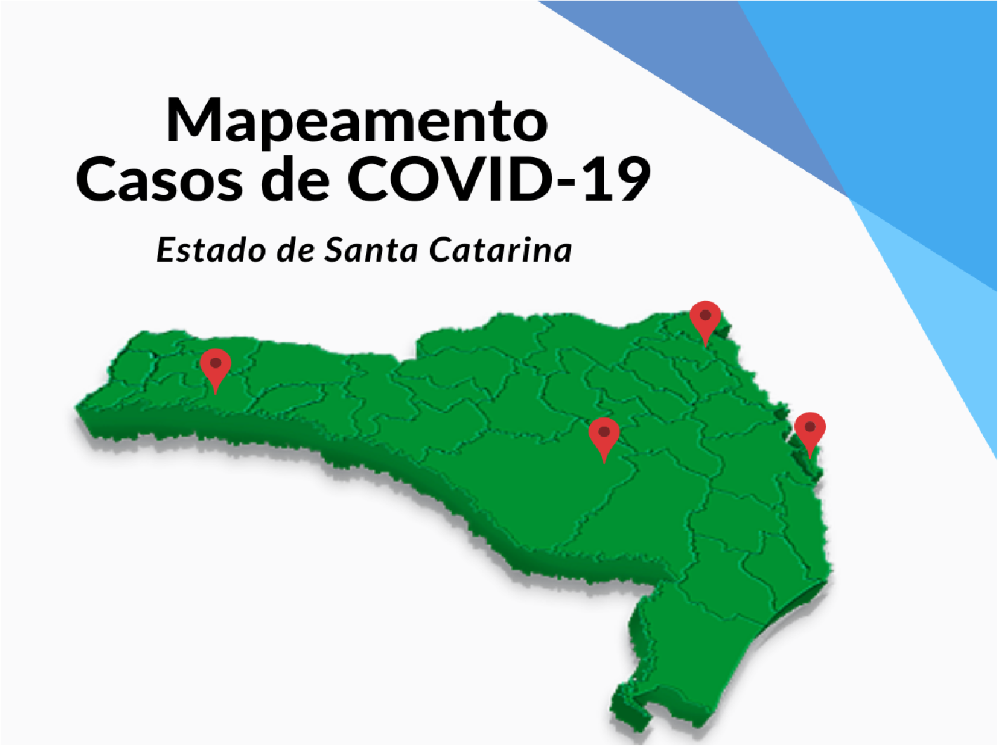

Neste dataset iremos trazer um mapeamento dos casos de covid-19 que se iniciou pelo Mundo em 31 de dezembro de 2019, a Organização Mundial da Saúde (OMS) foi alertada sobre vários casos de pneumonia na cidade de Wuhan, província de Hubei, na República Popular da China. Tratava-se de uma nova cepa (tipo) de coronavírus que não havia sido identificada antes em seres humanos.
Uma semana depois, em 7 de janeiro de 2020, as autoridades chinesas confirmaram que haviam identificado um novo tipo de coronavírus. Os coronavírus estão por toda parte. Eles são a segunda principal causa de resfriado comum (após rinovírus) e, até as últimas décadas, raramente causavam doenças mais graves em humanos do que o resfriado comum.

É a sexta vez na história que uma Emergência de Saúde Pública de Importância Internacional é declarada. As outras foram:


**25 de abril de 2009:** pandemia de H1N1

**5 de maio de 2014:** disseminação internacional de poliovírus

**8 agosto de 2014:** surto de Ebola na África Ocidental

**1 de fevereiro de 2016:** vírus zika e aumento de casos de microcefalia e outras malformações congênitas

**18 maio de 2018:** surto de ebola na República Democrática do Congo

Neste trabalho analisaremos os municipios com maior indice de Obitos no Estado de Santa Catarina, que são:  Blumenau, Chapecó, Florianópolis, Itajaí, Joinville.

Fonte: https://covid.saude.gov.br/

Esta base de dados do presente trabalho foi retirada no site acima, como os dados estavam separados por semestres, foi preciso utilziar o comando **Concat** para junção de todos os dados e criar apenas uma tabela, como mostra as entradas a baixo.

**Dados atualizados até 19/08/2022**

tamanho: 4.923.112 linhas e 17 colunas

Infomações:

contato: diogoantoniodejesus@hotmail.com

Contato: (47) 99672-3562

In [ ]:
#dados_20201 = pd.read_csv('/content/covid2020_Parte1_19ago2022.csv', on_bad_lines='skip', sep=';')
#dados_20202 = pd.read_csv('/content/covid2020_Parte2_19ago2022.csv', on_bad_lines='skip', sep=';')
#dados_20211 = pd.read_csv('/content/covid2021_Parte1_19ago2022.csv', on_bad_lines='skip', sep=';')
#dados_20212 = pd.read_csv('/content/covid2021_Parte2_19ago2022.csv', on_bad_lines='skip', sep=';')
#dados_20221 = pd.read_csv('/content/covid2022_Parte1_19ago2022.csv', on_bad_lines='skip', sep=';')
#dados_20222 = pd.read_csv('/content/covid2022_Parte2_19ago2022.csv', on_bad_lines='skip', sep=';')

In [ ]:
#dados_20201.shape, dados_20202.shape, dados_20211.shape, dados_20212.shape, dados_20221.shape, dados_20222.shape

In [ ]:
#lista = [dados_20201, dados_20202, dados_20211, dados_20212, dados_20221, dados_20222]
#tabela_completa = pd.concat(lista, ignore_index=True)
#tabela_completa = tabela_completa.sort_values(by='data')

# **Bases de Dados**


In [ ]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from datetime import date

# comando para ignorar os erros
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# dataset atualizado ate o mes de agosto de 2022
dateparse = lambda dates: pd.datetime.strptime(dates, '%Y-%m-%d')
dados_sc = pd.read_excel('/content/fullcovid.xlsx',parse_dates = ['data'], date_parser = dateparse )



In [ ]:
# base de dados onde consta toda latitude e longitude das localidades do Brasil
# Estes dados utilziaremos mais a frente para plotar um mapa de calor
lat_long = pd.read_excel('/content/cidades_latitude_longitude.xlsx')

In [ ]:
dados_sc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260203 entries, 0 to 260202
Data columns (total 17 columns):
 #   Column                  Non-Null Count   Dtype         
---  ------                  --------------   -----         
 0   regiao                  260203 non-null  object        
 1   estado                  260203 non-null  object        
 2   municipio               258420 non-null  object        
 3   coduf                   260203 non-null  int64         
 4   codmun                  259296 non-null  float64       
 5   codRegiaoSaude          258420 non-null  float64       
 6   nomeRegiaoSaude         258420 non-null  object        
 7   data                    260203 non-null  datetime64[ns]
 8   semanaEpi               260203 non-null  int64         
 9   populacaoTCU2019        259327 non-null  float64       
 10  casosAcumulado          260203 non-null  int64         
 11  casosNovos              260203 non-null  int64         
 12  obitosAcumulado         260203

In [ ]:
dados_sc.isnull().sum()

regiao                         0
estado                         0
municipio                   1783
coduf                          0
codmun                       907
codRegiaoSaude              1783
nomeRegiaoSaude             1783
data                           0
semanaEpi                      0
populacaoTCU2019             876
casosAcumulado                 0
casosNovos                     0
obitosAcumulado                0
obitosNovos                    0
Recuperadosnovos          260203
emAcompanhamentoNovos     260203
interior/metropolitana      1783
dtype: int64

In [ ]:
dados_sc['municipio'].value_counts()

Camboriú              876
Porto Belo            876
Três Barras           876
Treviso               876
Timbó Grande          876
                     ... 
Curitibanos           876
Dionísio Cerqueira    876
Cunha Porã            876
Criciúma              876
Ilhota                876
Name: municipio, Length: 295, dtype: int64

In [ ]:
# total de mortes e casos em todo estado em todo periodo da Covid19
agrupado_total_estado = dados_sc.groupby('municipio')['obitosNovos','casosNovos', 'municipio'].sum().reset_index()
print('total de mortes é',agrupado_total_estado['obitosNovos'].sum())
print('total de casos é',agrupado_total_estado['casosNovos'].sum())


total de mortes é 22329
total de casos é 1855910


In [ ]:
# total de mortes e casos nos ultimos 12 meses no estado de SC
estado_2021_8_2022_8 = dados_sc.query('data >= "2021-08-01"')
estado_2021_8_2022_8.groupby('municipio')['obitosNovos','casosNovos', 'municipio'].sum().reset_index()

print('total de mortes em 12 meses é',estado_2021_8_2022_8['obitosNovos'].sum())
print('total de casos em 12 meses é',estado_2021_8_2022_8['casosNovos'].sum())

total de mortes em 12 meses é 8702
total de casos em 12 meses é 1484306


In [ ]:
# total de mortes e casos em 2022 no estado de SC
estado_2022_1_2022_8 = dados_sc.query('data >= "2022-01-01"')
estado_2022_1_2022_8.groupby('municipio')['obitosNovos','casosNovos', 'municipio'].sum().reset_index()

print('total de mortes em em 2022 é',estado_2022_1_2022_8['obitosNovos'].sum())
print('total de casos em 2022 é',estado_2022_1_2022_8['casosNovos'].sum())

total de mortes em em 2022 é 4286
total de casos em 2022 é 1224750


In [ ]:
# criando datafram de mortes total por municipios para facilitar no plot
Novoscasos = ["Total Casos", "Total de Casos em 12 Meses", "Total de Casos de 2022"]
NCasos = [1855910,1484306, 1224750]
df1 = pd.DataFrame(list(zip(Novoscasos,NCasos)), columns = ['Casos','Numero Casos'])
x = df1['Casos']
y = df1['Numero Casos']

# criando datafram de mortes total por municipios para facilitar no plot
Novoscasos = ["Total Obitos", "Total de Obitos em 12 Meses", "Total de obitos de 2022"]
Obitos = [22329,8702, 4286]
df1 = pd.DataFrame(list(zip(Novoscasos,Obitos)), columns = ['Casos','Obitos'])
x1 = df1['Casos']
y1 = df1['Obitos'] 

# <font color='red' style='font-size: 40px;'> Visualização   </font>
<hr style='border: 2px solid red;'>
  
 A baixo iremos visualizar os graficos de mortes e os novos casos de coranavirus no Estado de Santa Catarina.     

Em Santa Catarina temos 44.658 obitos	e 3.711.820 e casos de coronavirus

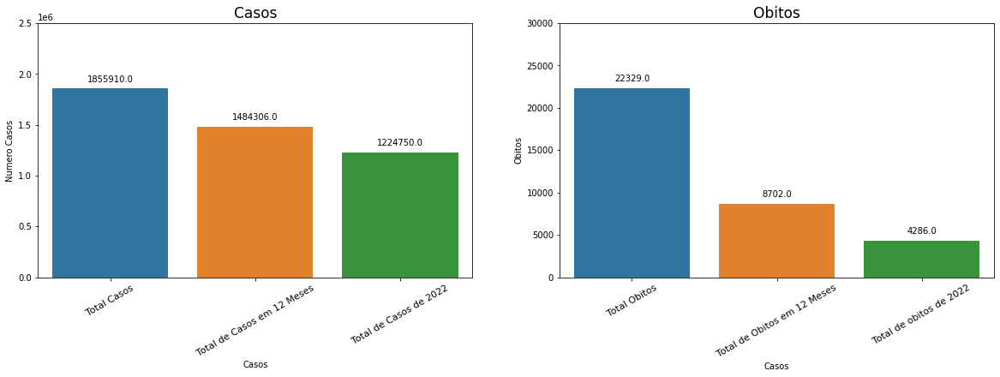

In [ ]:
plt.figure(figsize = ((20, 12)))
plt.subplot(2, 2, 1)
vplot = sns.barplot(x,y)
plt.ylim(0, 2500000)
plt.xticks(fontsize=11, rotation=30)
plt.title("Casos", fontsize = 17)

plt.subplot(2, 2, 2)
vplot1 = sns.barplot(x1,y1)
plt.ylim(0, 30000)
plt.xticks(fontsize=11, rotation=30)
plt.title("Obitos", fontsize = 17)

for p in vplot.patches: 
    vplot.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')
for p in vplot1.patches: 
    vplot1.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')
plt.show();

Text(0, 0.5, 'Obitos')

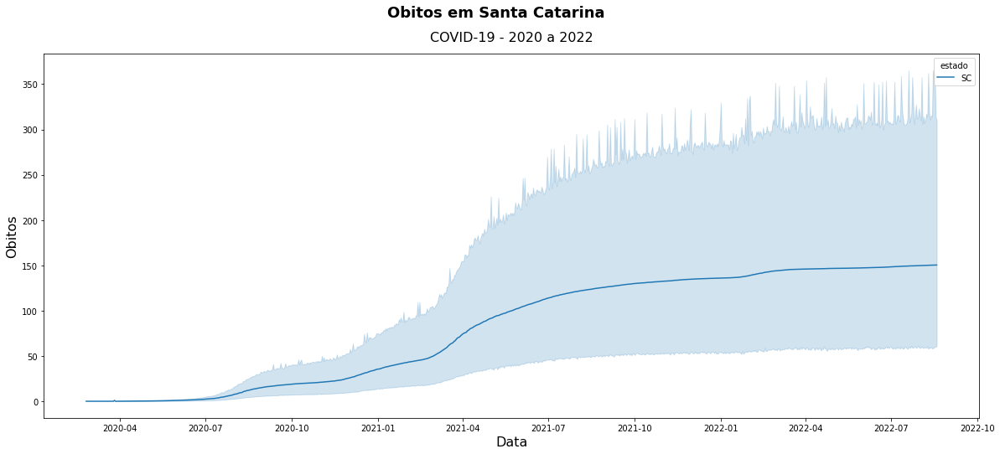

In [ ]:
plt.figure(figsize=(20,8))
fig = sns.lineplot(x='data', y='obitosAcumulado', hue='estado', data=dados_sc)
plt.suptitle("Obitos em Santa Catarina", size = 18, weight='bold')
plt.title("COVID-19 - 2020 a 2022", fontsize = 16, pad = 15)
fig.set_xlabel('Data', fontsize=16)
fig.set_ylabel('Obitos', fontsize=16)

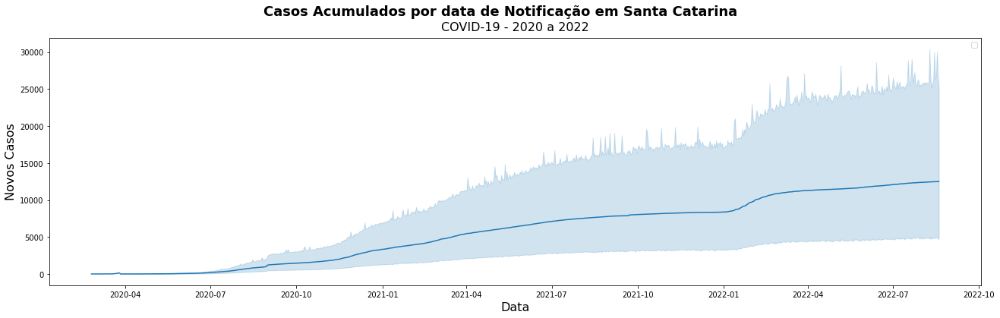

In [ ]:
plt.figure(figsize=(22,6))
sns.lineplot(dados_sc['data'], dados_sc['casosAcumulado'])
plt.suptitle("Casos Acumulados por data de Notificação em Santa Catarina", size = 18, weight='bold')
plt.title("COVID-19 - 2020 a 2022", fontsize = 16, pad = 9)
plt.xlabel('Data', fontsize=16)
plt.ylabel('Novos Casos', fontsize=16, rotation=90)
plt.legend()
plt.show()

# SELECIONANDO OS MUNICIPIOS

In [ ]:
agrupado_total = dados_sc.groupby('municipio')['obitosNovos','municipio'].sum().reset_index()
agrupado_total = agrupado_total.sort_values(by='obitosNovos', ascending=False).head(20)
agrupado_total = agrupado_total.reset_index(drop=True)
x2 = agrupado_total['municipio']
y2 = agrupado_total['obitosNovos']

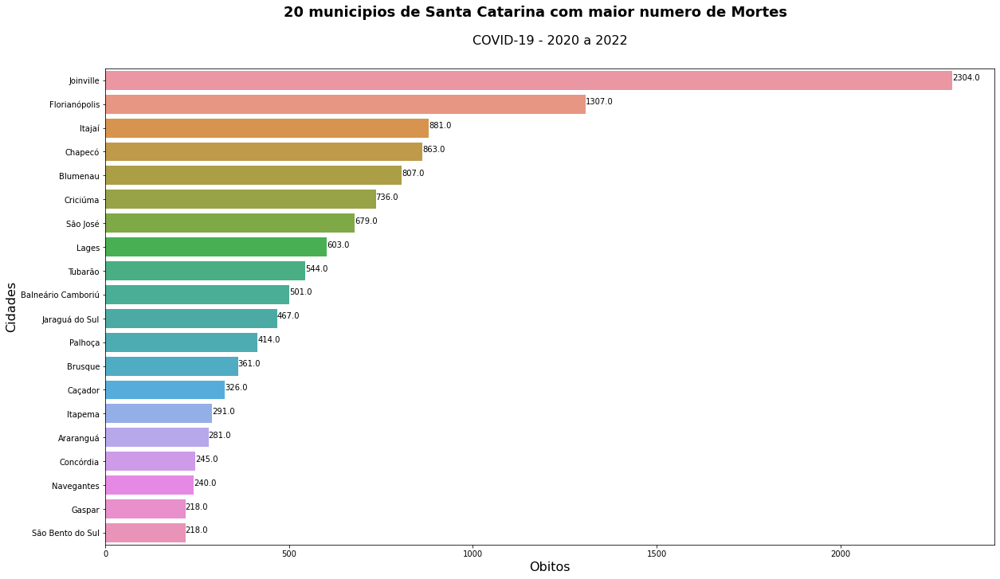

In [ ]:
plt.figure(figsize=(20, 11)) 
ax = sns.barplot(x=y2.sort_values(ascending=False), y=agrupado_total['municipio'], 
                    data=agrupado_total)

total=len(agrupado_total['obitosNovos'])
for p in ax.patches:
    contagem = format(p.get_width())
    width, height =p.get_width(),p.get_height()
    xx=p.get_x()+width+0.02
    yy=p.get_y()+height/2
    ax.annotate(contagem,(xx,yy))

plt.suptitle("20 municipios de Santa Catarina com maior numero de Mortes", size = 18, weight='bold')
plt.title("COVID-19 - 2020 a 2022", fontsize = 16, pad = 30)
plt.ylabel("Cidades",fontsize = 16)
plt.xlabel("Obitos", fontsize = 16);



In [ ]:
# buscaremos os municipios com maior numero de obitos no estado de sc
dados_municipios = dados_sc[dados_sc['municipio'].isin(['Blumenau', 'Itajaí', 'Chapecó','Florianópolis', 'Joinville'])]
dados_municipios.shape

(4380, 17)

In [ ]:
# filtrando os municipios
itajai_casos = dados_municipios.query('municipio == "Itajaí"')
blum_casos = dados_municipios.query('municipio == "Blumenau"')
chap_casos = dados_municipios.query('municipio == "Chapecó"')
floripa_casos = dados_municipios.query('municipio == "Florianópolis"')
joinville_casos = dados_municipios.query('municipio == "Joinville"')

In [ ]:
itajai_casos.head(3)

,regiao,estado,municipio,coduf,codmun,codRegiaoSaude,nomeRegiaoSaude,data,semanaEpi,populacaoTCU2019,casosAcumulado,casosNovos,obitosAcumulado,obitosNovos,Recuperadosnovos,emAcompanhamentoNovos,interior/metropolitana
125,Sul,SC,Itajaí,42,420820.0,42005.0,FOZ DO RIO ITAJAI,2020-03-27,13,219536.0,0,0,0,0,NaN,NaN,0.0
455,Sul,SC,Itajaí,42,420820.0,42005.0,FOZ DO RIO ITAJAI,2020-03-28,13,219536.0,18,18,0,0,NaN,NaN,0.0
675,Sul,SC,Itajaí,42,420820.0,42005.0,FOZ DO RIO ITAJAI,2020-03-29,14,219536.0,18,0,0,0,NaN,NaN,0.0


In [ ]:
# calculando a diferença de mortes por dias
itajai_casos['velocidade_obito'] = itajai_casos["obitosAcumulado"].diff()
itajai_casos['aumento'] = itajai_casos['velocidade_obito'].diff()

blum_casos['velocidade_obito'] = blum_casos["obitosAcumulado"].diff()
blum_casos['aumento'] = blum_casos["velocidade_obito"].diff()

chap_casos['velocidade_obito'] = chap_casos["obitosAcumulado"].diff()
chap_casos['aumento'] = chap_casos["velocidade_obito"].diff()

floripa_casos['velocidade_obito'] = floripa_casos["obitosAcumulado"].diff()
floripa_casos['aumento'] = floripa_casos["velocidade_obito"].diff()

joinville_casos['velocidade_obito'] = joinville_casos["obitosAcumulado"].diff()
joinville_casos['aumento'] = joinville_casos["velocidade_obito"].diff()

In [ ]:
itajai_casos.head(3)

,regiao,estado,municipio,coduf,codmun,codRegiaoSaude,nomeRegiaoSaude,data,semanaEpi,populacaoTCU2019,casosAcumulado,casosNovos,obitosAcumulado,obitosNovos,Recuperadosnovos,emAcompanhamentoNovos,interior/metropolitana,velocidade_obito,aumento
125,Sul,SC,Itajaí,42,420820.0,42005.0,FOZ DO RIO ITAJAI,2020-03-27,13,219536.0,0,0,0,0,NaN,NaN,0.0,NaN,NaN
455,Sul,SC,Itajaí,42,420820.0,42005.0,FOZ DO RIO ITAJAI,2020-03-28,13,219536.0,18,18,0,0,NaN,NaN,0.0,0.0,NaN
675,Sul,SC,Itajaí,42,420820.0,42005.0,FOZ DO RIO ITAJAI,2020-03-29,14,219536.0,18,0,0,0,NaN,NaN,0.0,0.0,0.0


In [ ]:
# visualizando numero total de mortes acumaladas por municipio
Total_mortes_Itajai = print('Numero de mortes por covid em itajai é', itajai_casos.obitosAcumulado.max())
Total_mortes_Blumenau= print('Numero de mortes por covid em blumenau é', blum_casos.obitosAcumulado.max())
Total_mortes_Chapeco = print('Numero de mortes por covid em chapeco é', chap_casos.obitosAcumulado.max())
Total_mortes_Florianopolis = print('Numero de mortes por covid em florianopolis é', floripa_casos.obitosAcumulado.max())
Total_mortes_Joinville = print('Numero de mortes por covid em joinville é', joinville_casos.obitosAcumulado.max())

Numero de mortes por covid em itajai é 881
Numero de mortes por covid em blumenau é 807
Numero de mortes por covid em chapeco é 863
Numero de mortes por covid em florianopolis é 1307
Numero de mortes por covid em joinville é 2304


# <font color='red' style='font-size: 40px;'> Os 5 municipios com maior numero de mortes em Santa Catarina.   </font>
<hr style='border: 2px solid red;'>


In [ ]:
# criando datafram de mortes total por municipios para facilitar no plot
Cidades = ["Joinville", "Florianopolis", "Itajai", "Chapeco","Blumenau"]
Obitos = [2304,1307, 881, 863, 807]
df = pd.DataFrame(list(zip(Cidades,Obitos)), columns = ['Cidades','Obitos'])
df 

,Cidades,Obitos
0,Joinville,2304
1,Florianopolis,1307
2,Itajai,881
3,Chapeco,863
4,Blumenau,807


In [ ]:
# criando uma media movel de 7 periodos para cada municipio
itajai_casos['media_movel_7'] = itajai_casos['velocidade_obito'].rolling(7).mean()
blum_casos['media_movel_7'] = blum_casos['velocidade_obito'].rolling(7).mean()
chap_casos['media_movel_7'] = chap_casos['velocidade_obito'].rolling(7).mean()
floripa_casos['media_movel_7'] = floripa_casos['velocidade_obito'].rolling(7).mean()
joinville_casos['media_movel_7'] = joinville_casos['velocidade_obito'].rolling(7).mean()

# criando uma media movel de 7 periodos para cada municipio
itajai_casos['mediamovel_7_aumento'] = itajai_casos['aumento'].rolling(7).mean()
blum_casos['mediamovel_7_aumento'] = blum_casos['aumento'].rolling(7).mean()
chap_casos['mediamovel_7_aumento'] = chap_casos['aumento'].rolling(7).mean()
floripa_casos['mediamovel_7_aumento'] = floripa_casos['aumento'].rolling(7).mean()
joinville_casos['mediamovel_7_aumento'] = joinville_casos['aumento'].rolling(7).mean()

In [ ]:
indexesProblematicos1 = itajai_casos[itajai_casos.velocidade_obito < 0].index
itajai_casos.drop(indexesProblematicos1, inplace=True)

indexesProblematicos2 = blum_casos[blum_casos.velocidade_obito < 0].index
blum_casos.drop(indexesProblematicos2, inplace=True)

indexesProblematicos4 = chap_casos[chap_casos.velocidade_obito < 0].index
chap_casos.drop(indexesProblematicos4, inplace=True)

indexesProblematicos6 = floripa_casos[floripa_casos.velocidade_obito < 0].index
floripa_casos.drop(indexesProblematicos6, inplace=True)

indexesProblematicos7 = joinville_casos[joinville_casos.velocidade_obito < 0].index
joinville_casos.drop(indexesProblematicos7, inplace=True)

In [ ]:
joinville_casos

,regiao,estado,municipio,coduf,codmun,codRegiaoSaude,nomeRegiaoSaude,data,semanaEpi,populacaoTCU2019,...,casosNovos,obitosAcumulado,obitosNovos,Recuperadosnovos,emAcompanhamentoNovos,interior/metropolitana,velocidade_obito,aumento,media_movel_7,mediamovel_7_aumento
48,Sul,SC,Joinville,42,420910.0,42011.0,NORDESTE,2020-03-27,13,590466.0,...,0,0,0,NaN,NaN,0.0,NaN,NaN,NaN,NaN
338,Sul,SC,Joinville,42,420910.0,42011.0,NORDESTE,2020-03-28,13,590466.0,...,9,0,0,NaN,NaN,0.0,0.0,NaN,NaN,NaN
918,Sul,SC,Joinville,42,420910.0,42011.0,NORDESTE,2020-03-29,14,590466.0,...,0,0,0,NaN,NaN,0.0,0.0,0.0,NaN,NaN
1188,Sul,SC,Joinville,42,420910.0,42011.0,NORDESTE,2020-03-30,14,590466.0,...,0,0,0,NaN,NaN,0.0,0.0,0.0,NaN,NaN
1268,Sul,SC,Joinville,42,420910.0,42011.0,NORDESTE,2020-03-31,14,590466.0,...,5,1,1,NaN,NaN,0.0,1.0,1.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
258931,Sul,SC,Joinville,42,420910.0,42011.0,NORDESTE,2022-08-15,33,590466.0,...,25,2301,1,NaN,NaN,0.0,1.0,0.0,0.857143,0.142857
259097,Sul,SC,Joinville,42,420910.0,42011.0,NORDESTE,2022-08-16,33,590466.0,...,71,2302,1,NaN,NaN,0.0,1.0,0.0,0.857143,0.000000
259453,Sul,SC,Joinville,42,420910.0,42011.0,NORDESTE,2022-08-17,33,590466.0,...,47,2302,0,NaN,NaN,0.0,0.0,-1.0,0.571429,-0.285714
259722,Sul,SC,Joinville,42,420910.0,42011.0,NORDESTE,2022-08-18,33,590466.0,...,69,2303,1,NaN,NaN,0.0,1.0,1.0,0.571429,0.000000


# <font color='red' style='font-size: 40px;'> Morte por dia em cada Municipio.   </font>
<hr style='border: 2px solid red;'>
  
 A baixo iremos visualizar os graficos de mortes por dia e a media movel de mortes em cada municipio.

A baixo sera notado que 

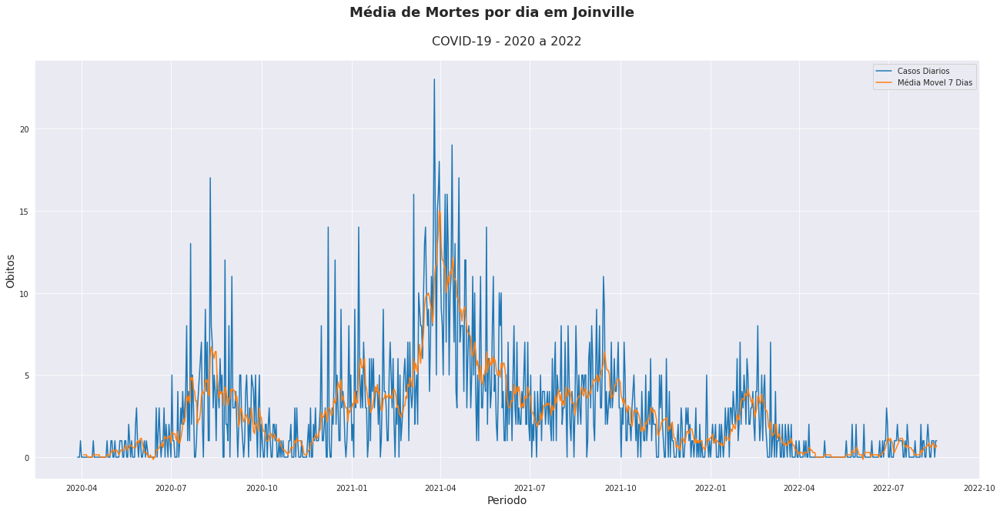

In [ ]:
# plotando as mortes diarias por covid no municipio de joinville
sns.set_style('darkgrid')
ax = sns.lineplot(x='data', y='velocidade_obito', data=joinville_casos, label = 'Casos Diarios')
sns.lineplot(x='data', y='media_movel_7', data=joinville_casos, label= 'Média Movel 7 Dias')
ax.figure.set_size_inches(22,10) 
plt.suptitle("Média de Mortes por dia em Joinville", size = 18, weight='bold')
plt.title("COVID-19 - 2020 a 2022", fontsize = 16, pad = 20)
ax.set_xlabel('Periodo', fontsize=14)
ax.set_ylabel('Obitos', fontsize=14)
ax = ax 

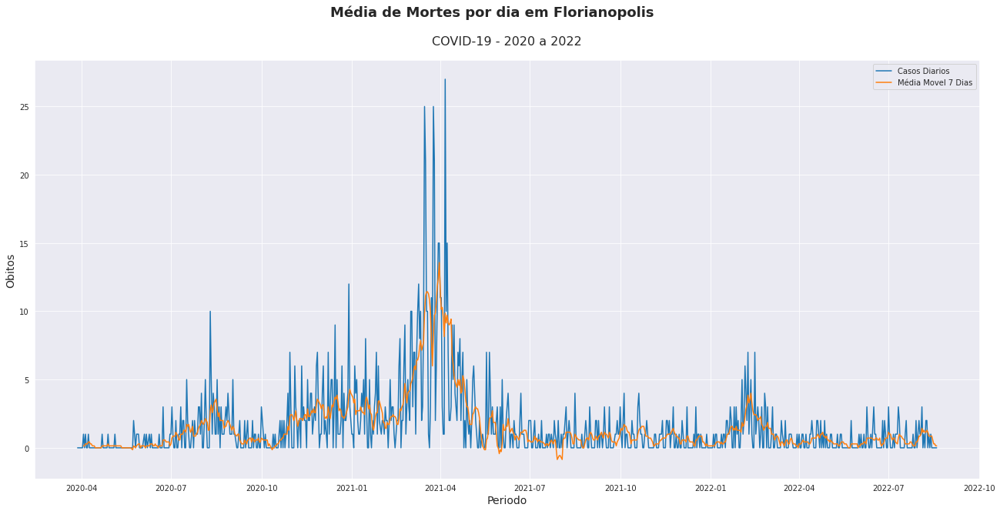

In [ ]:
# plotando as mortes diarias por covid no municipio de Florianopolis
sns.set_style('darkgrid')
ax = sns.lineplot(x='data', y='velocidade_obito', data=floripa_casos, label = 'Casos Diarios')
sns.lineplot(x='data', y='media_movel_7', data=floripa_casos, label= 'Média Movel 7 Dias')
ax.figure.set_size_inches(22,10) 
plt.suptitle("Média de Mortes por dia em Florianopolis", size = 18, weight='bold')
plt.title("COVID-19 - 2020 a 2022", fontsize = 16, pad = 20)
ax.set_xlabel('Periodo', fontsize=14)
ax.set_ylabel('Obitos', fontsize=14)
ax = ax 

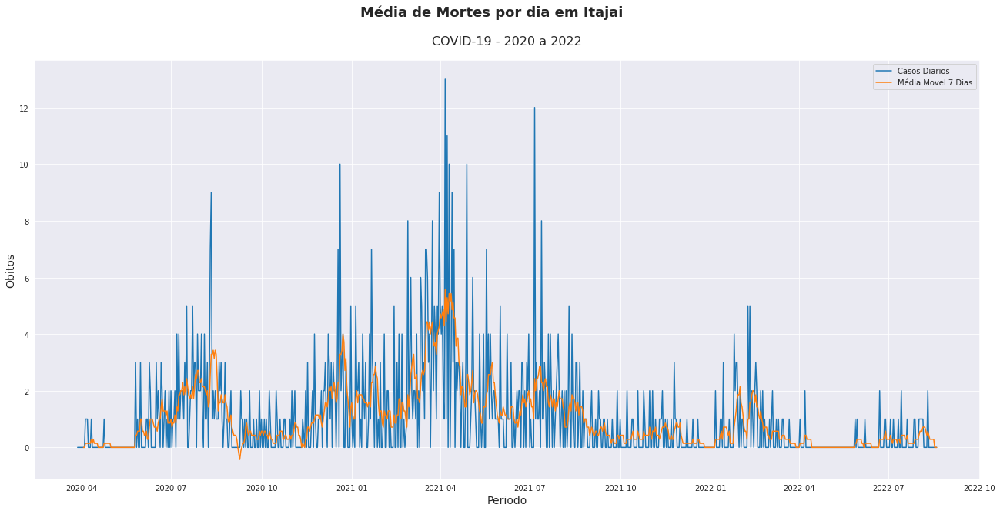

In [ ]:
# plotando as mortes diarias por covid no municipio de Itajai
sns.set_style('darkgrid')
ax = sns.lineplot(x='data', y='velocidade_obito', data=itajai_casos, label = 'Casos Diarios')
sns.lineplot(x='data', y='media_movel_7', data=itajai_casos, label= 'Média Movel 7 Dias')
ax.figure.set_size_inches(22,10) 
plt.suptitle("Média de Mortes por dia em Itajai", size = 18, weight='bold')
plt.title("COVID-19 - 2020 a 2022", fontsize = 16, pad = 20)
ax.set_xlabel('Periodo', fontsize=14)
ax.set_ylabel('Obitos', fontsize=14)
ax = ax 

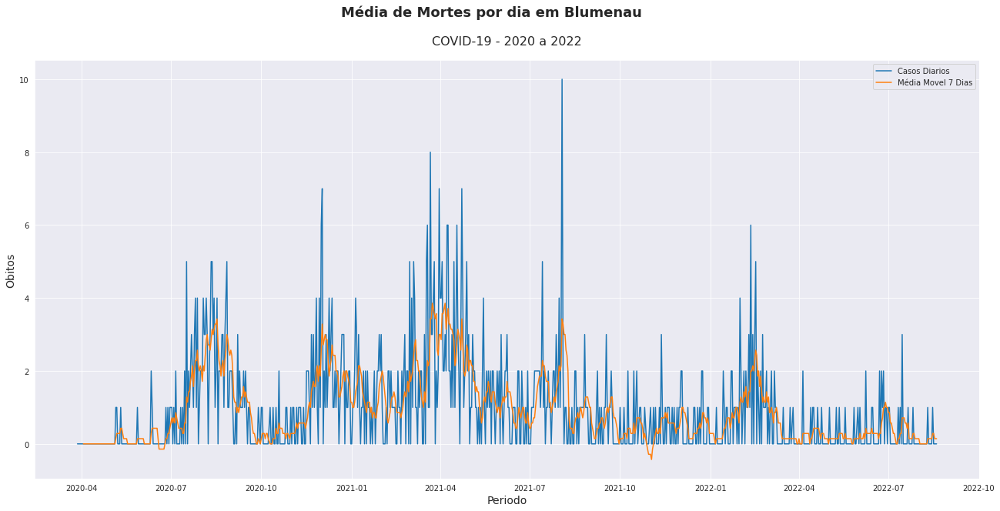

In [ ]:
# plotando as mortes diarias por covid no municipio de Blumenau
sns.set_style('darkgrid')
ax = sns.lineplot(x='data', y='velocidade_obito', data=blum_casos, label = 'Casos Diarios')
sns.lineplot(x='data', y='media_movel_7', data=blum_casos, label= 'Média Movel 7 Dias')
ax.figure.set_size_inches(22,10) 
plt.suptitle("Média de Mortes por dia em Blumenau", size = 18, weight='bold')
plt.title("COVID-19 - 2020 a 2022", fontsize = 16, pad = 20)
ax.set_xlabel('Periodo', fontsize=14)
ax.set_ylabel('Obitos', fontsize=14)
ax = ax 

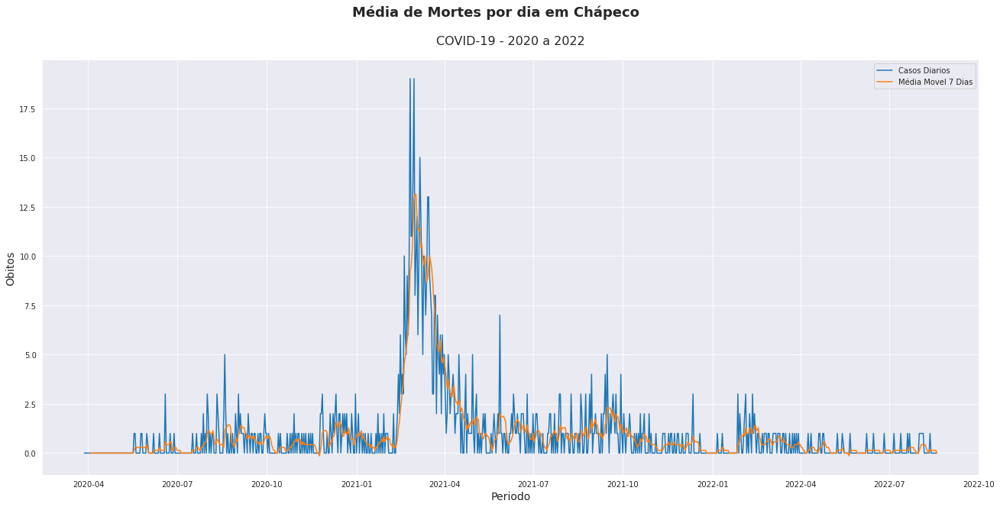

In [ ]:
# plotando as mortes diarias por covid no municipio de Chapeco
sns.set_style('darkgrid')
ax = sns.lineplot(x='data', y='velocidade_obito', data=chap_casos, label = 'Casos Diarios')
sns.lineplot(x='data', y='media_movel_7', data=chap_casos, label= 'Média Movel 7 Dias')
ax.figure.set_size_inches(22,10) 
plt.suptitle("Média de Mortes por dia em Chápeco", size = 18, weight='bold')
plt.title("COVID-19 - 2020 a 2022", fontsize = 16, pad = 20)
ax.set_xlabel('Periodo', fontsize=14)
ax.set_ylabel('Obitos', fontsize=14)
ax = ax 

# <font color='red' style='font-size: 40px;'> Numero total de mortes por Covid-19 em cada Municipio.   </font>
<hr style='border: 2px solid red;'>
  
 Veja a diferença entre o primeiro municipio e os 2 ultimos, Balneario Camboriu e Brusque juntos somados chegam apenas 37% do numero de mortes de Joinville.

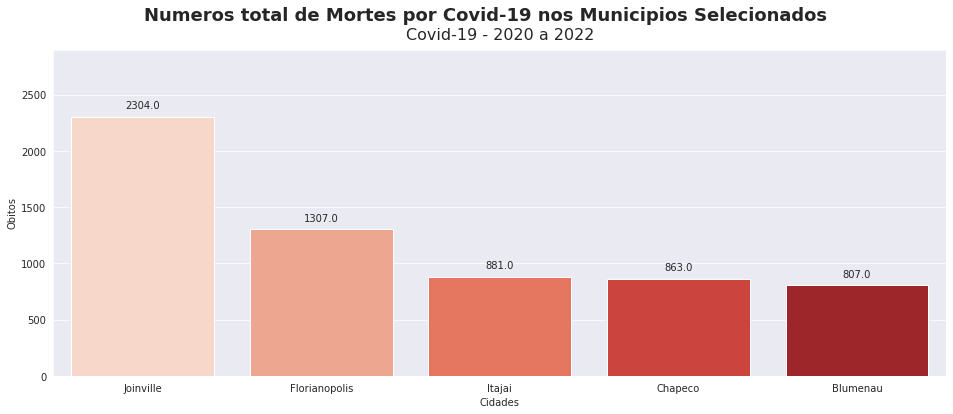

In [ ]:
plt.figure(figsize=(16, 6)) 
splot = sns.barplot(x="Cidades", y=df["Obitos"].sort_values(ascending=True), 
                    data=df, palette='Reds')
plt.ylim(0, 2900)

  
for p in splot.patches: 
    splot.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')
    
plt.suptitle("Numeros total de Mortes por Covid-19 nos Municipios Selecionados", size = 18, weight='bold')
plt.title("Covid-19 - 2020 a 2022", fontsize = 16, pad = 10)
plt.ylabel("Obitos")
plt.xlabel("Cidades");

In [ ]:
# itajai_casos
# blum_casos
# chap_casos
# floripa_casos 
# joinville_casos 

# <font color='red' style='font-size: 40px;'> Casos Acumulados nos Municipio Selecionados.   </font>
<hr style='border: 2px solid red;'>
  
 

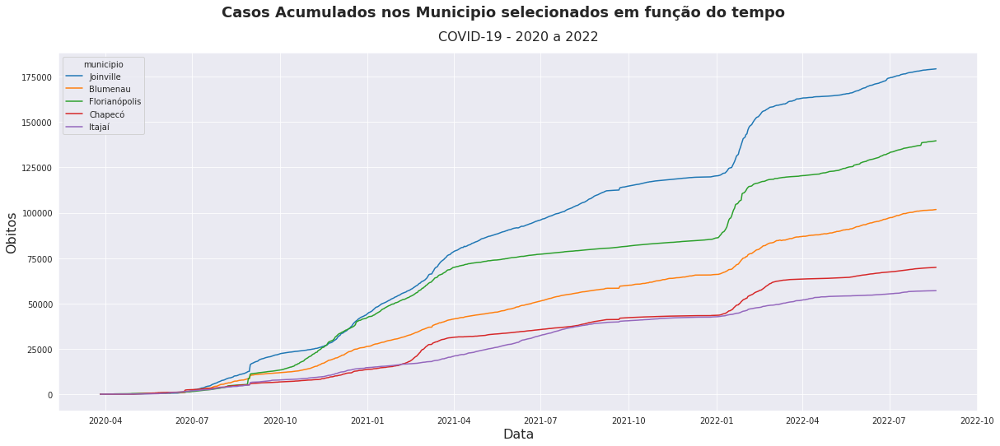

In [ ]:
plt.figure(figsize=(20,8))
fig = sns.lineplot(x='data', y='casosAcumulado', hue='municipio', data=dados_municipios)
plt.suptitle("Casos Acumulados nos Municipio selecionados em função do tempo", size = 18, weight='bold')
plt.title("COVID-19 - 2020 a 2022", fontsize = 16, pad = 15)
fig.set_xlabel('Data', fontsize=16)
fig.set_ylabel('Obitos', fontsize=16);

# <font color='red' style='font-size: 40px;'> Obitos Acumulados nos Municipio Selecionados.   </font>
<hr style='border: 2px solid red;'>

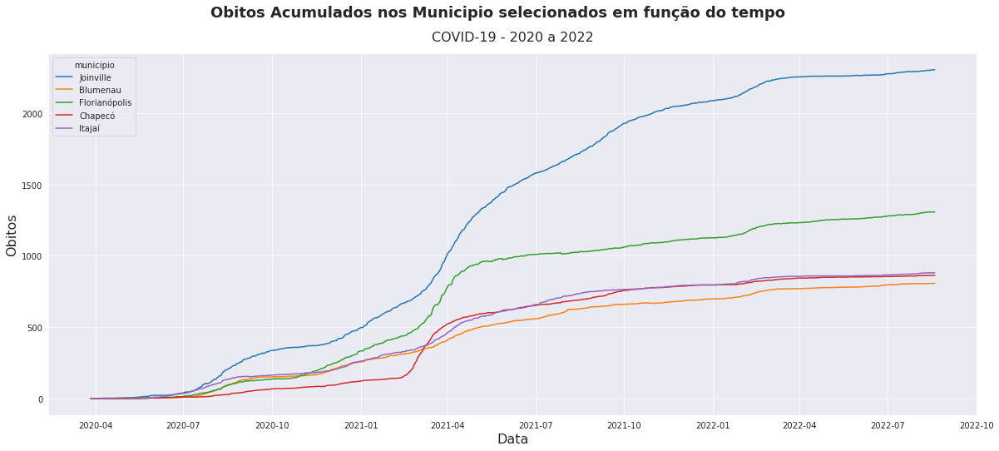

In [ ]:
plt.figure(figsize=(20,8))
fig = sns.lineplot(x='data', y='obitosAcumulado', hue='municipio', data=dados_municipios)
plt.suptitle("Obitos Acumulados nos Municipio selecionados em função do tempo", size = 18, weight='bold')
plt.title("COVID-19 - 2020 a 2022", fontsize = 16, pad = 15)
fig.set_xlabel('Data', fontsize=16)
fig.set_ylabel('Obitos', fontsize=16);

# <font color='red' style='font-size: 40px;'> As Principais cidades em relação ao numero de mortes em todo Estado.   </font>
<hr style='border: 2px solid red;'>

In [ ]:
# Gerando um DataFrame com o nome dos estado ordenados com a quantidade de aplicantes
city_qtd = pd.DataFrame({"UF": agrupado_total_estado["municipio"], "QTD": agrupado_total_estado['obitosNovos']})

# Renomeando todos os municipios que não são das principais sedes como 'Outros'
city_qtd.loc[city_qtd["QTD"] < 800, "UF"] = 'Outros'

# Gerando o gráfico de pizza com as nossas principais cidades em relação a todo Estado
fig = px.pie(city_qtd, values="QTD", names='UF', title='Proporção de Obitos dos Municipios em todo Estado de Santa Catarina', 
             width=800, height=725, color = 'UF',
             color_discrete_map={"FL": "#83aaf0",
                                 "ITJ": "#a8c3f2",
                                 "JOIN": "#cddbf3",
                                 "Outros": "#f3f3f4"})
# Escrevendo os labels e percentuais
fig.update_traces(textposition='inside', textinfo='percent+label',
                  marker=dict(line=dict(color='#FFFFFF', width=1)))

# Ocultando a legenda
fig.update(layout_showlegend=False)
fig.show()

# Blumenau 13,1%, Chapecó 14%, Florianópolis 21,2%, Itajaí 14,3%, Joinville 37,4%.

In [ ]:
todas_latitudes = lat_long.rename(columns = {'nome':'municipio'})
tabela_completa_mortes = pd.merge(left=todas_latitudes, right=dados_sc, on = 'municipio')

# <font color='red' style='font-size: 40px;'> Mapa de calor de todos os Municipios de Santa Catarina mostrando o numero de Obitos.   </font>
<hr style='border: 2px solid red;'>
  
 Notamos que os municipios proximo ao litoral como o vale do Itajai, Joinville, Grande Florianopolis e região sul de Criciuma são os locais onde mais possuem obitos nos municipios, conforme nos mostra o mapa de calor a baixo.

In [ ]:
px.density_mapbox(
    tabela_completa_mortes,
    lat='LATITUDE',
    lon='LONGITUDE',
    title='Mapa de calor de mortes por Covid-19 em Santa Catarina',
    z='obitosAcumulado',
    radius=5,
    center=dict(lat=-27.2828504, lon=-50.58207635),
    zoom=5.6,
    mapbox_style='stamen-terrain')

# <font color='red' style='font-size: 40px;'> Óbitos por dia da semana dos Municipios.   </font>
<hr style='border: 2px solid red;'>
  
 Tambem notamos que os dias da semana podem nos trazer informações importantes referente aos dias que tendem a ter mais mortes, um exemplo é entre segunda e terça-feira onde a maioria dos municipios mostram um maior volume de obitos, já nos finais de semana o numero de obitos cai drasticamente.

In [ ]:
itajai_casos['mes'] = pd.to_datetime(itajai_casos['data'])
itajai_casos['dia_da_semana'] = itajai_casos['mes'].dt.day_name()

blum_casos['mes'] = pd.to_datetime(blum_casos['data'])
blum_casos['dia_da_semana'] = blum_casos['mes'].dt.day_name()  

chap_casos['mes'] = pd.to_datetime(chap_casos['data'])
chap_casos['dia_da_semana'] = chap_casos['mes'].dt.day_name()

floripa_casos['mes'] = pd.to_datetime(floripa_casos['data'])
floripa_casos['dia_da_semana'] = floripa_casos['mes'].dt.day_name() 

joinville_casos['mes'] = pd.to_datetime(joinville_casos['data'])
joinville_casos['dia_da_semana'] = joinville_casos['mes'].dt.day_name() 

In [ ]:
dias_traduzidos = {'Monday':'Segunda','Tuesday':'Terça','Wednesday':'Quarta',
                  'Thursday':'Quinta','Friday':'Sexta','Saturday':'Sabado',
                  'Sunday':'Domingo'}

itajai_casos['dia_da_semana'] = itajai_casos['dia_da_semana'].map(dias_traduzidos)
blum_casos['dia_da_semana'] = blum_casos['dia_da_semana'].map(dias_traduzidos)
chap_casos['dia_da_semana'] = chap_casos['dia_da_semana'].map(dias_traduzidos)
floripa_casos['dia_da_semana'] = floripa_casos['dia_da_semana'].map(dias_traduzidos)
joinville_casos['dia_da_semana'] = joinville_casos['dia_da_semana'].map(dias_traduzidos)

agrupados_itj = itajai_casos.groupby('dia_da_semana')['velocidade_obito', 'casosNovos','dia_da_semana'].sum().round()
blum_casos = blum_casos.groupby('dia_da_semana')['velocidade_obito','casosNovos','dia_da_semana'].sum().round()
chap_casos = chap_casos.groupby('dia_da_semana')['velocidade_obito','casosNovos','dia_da_semana'].sum().round()
floripa_casos = floripa_casos.groupby('dia_da_semana')['velocidade_obito','casosNovos','dia_da_semana'].sum().round()
joinville_casos = joinville_casos.groupby('dia_da_semana')['velocidade_obito','casosNovos','dia_da_semana'].sum().round()

agrupados_itj = agrupados_itj.reindex(['Domingo','Segunda','Terça','Quarta','Quinta','Sexta','Sabado']).reset_index()
blum_casos = blum_casos.reindex(['Domingo','Segunda','Terça','Quarta','Quinta','Sexta','Sabado']).reset_index()
chap_casos = chap_casos.reindex(['Domingo','Segunda','Terça','Quarta','Quinta','Sexta','Sabado']).reset_index()
floripa_casos = floripa_casos.reindex(['Domingo','Segunda','Terça','Quarta','Quinta','Sexta','Sabado']).reset_index()
joinville_casos = joinville_casos.reindex(['Domingo','Segunda','Terça','Quarta','Quinta','Sexta','Sabado']).reset_index()

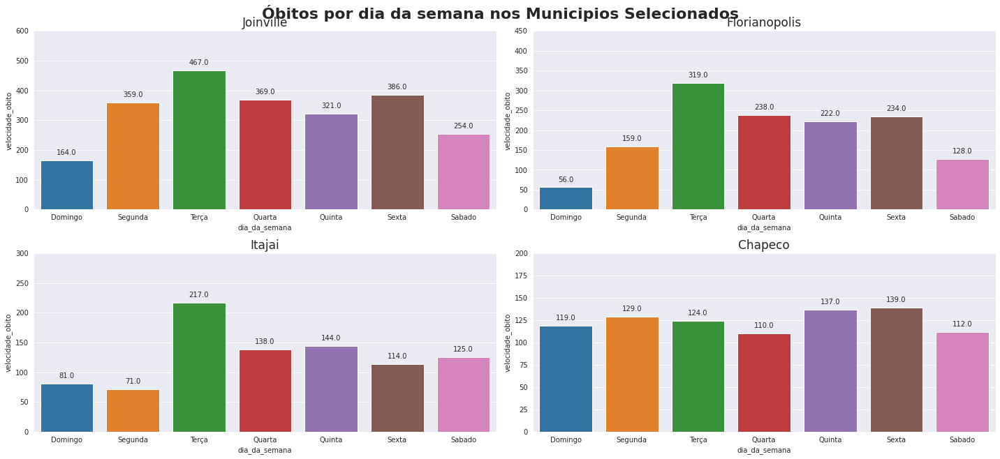

In [ ]:
plt.figure(figsize = ((20, 9)))

plt.subplot(2, 2, 1)
vplot = sns.barplot(joinville_casos['dia_da_semana'],joinville_casos.velocidade_obito)
plt.ylim(0, 600)
plt.title("Joinville", fontsize = 17)

plt.subplot(2, 2, 2)
vplot1 = sns.barplot(floripa_casos['dia_da_semana'],floripa_casos.velocidade_obito)
plt.ylim(0, 450)
plt.title("Florianopolis", fontsize = 17)

plt.subplot(2, 2, 3)
vplot2 = sns.barplot(agrupados_itj['dia_da_semana'],agrupados_itj.velocidade_obito)
plt.ylim(0, 300)
plt.title("Itajai", fontsize = 17)
plt.subplot(2, 2, 4)
vplot3 = sns.barplot(chap_casos['dia_da_semana'],chap_casos.velocidade_obito)
plt.ylim(0, 200)
plt.title("Chapeco", fontsize = 17)
plt.suptitle("Óbitos por dia da semana nos Municipios Selecionados", size = 22, weight='bold', x=0.50, y=1.05)
plt.subplots_adjust(left=0.125, bottom=0.1, right=0.9, top=0.9, wspace=0.2, hspace=0.35)
for p in vplot.patches: 
    vplot.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')
for p in vplot1.patches: 
    vplot1.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')
for p in vplot2.patches: 
    vplot2.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')
for p in vplot3.patches: 
    vplot3.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')

plt.tight_layout()    
plt.show()

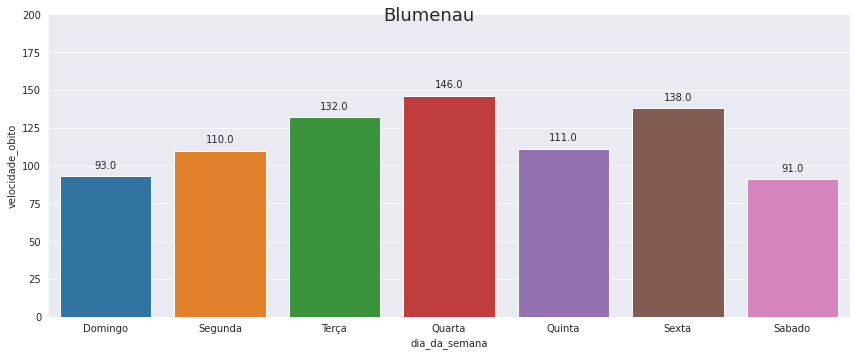

In [ ]:
plt.figure(figsize = ((12, 5)))
vplot5 = sns.barplot(blum_casos['dia_da_semana'],blum_casos.velocidade_obito)
plt.ylim(0, 200)
plt.suptitle("Blumenau", size = 18)
plt.subplots_adjust(left=0.125, bottom=0.1, right=0.9, top=0.9, wspace=0.2, hspace=0.35)
for p in vplot5.patches: 
    vplot5.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')
plt.tight_layout()    
plt.show()

# <font color='red' style='font-size: 40px;'> Novos casos por dia da semana dos Municipios.   </font>
<hr style='border: 2px solid red;'>
  
 Tambem notamos que os dias da semana podem nos trazer informações importantes referente aos dias que tendem a ter mais mortes, um exemplo é entre segunda e terça-feira onde a maioria dos municipios mostram um maior volume de obitos.

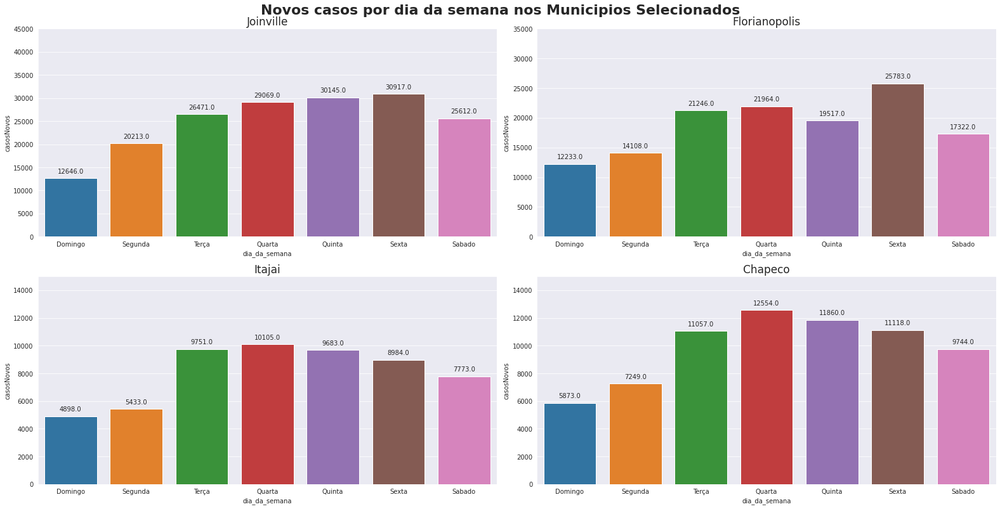

In [ ]:
plt.figure(figsize = ((22, 11)))

plt.subplot(2, 2, 1)
vplot = sns.barplot(joinville_casos['dia_da_semana'],joinville_casos.casosNovos)
plt.ylim(0, 45000)
plt.title("Joinville", fontsize = 17)

plt.subplot(2, 2, 2)
vplot1 = sns.barplot(floripa_casos['dia_da_semana'],floripa_casos.casosNovos)
plt.ylim(0, 35000)
plt.title("Florianopolis", fontsize = 17)

plt.subplot(2, 2, 3)
vplot2 = sns.barplot(agrupados_itj['dia_da_semana'],agrupados_itj.casosNovos)
plt.ylim(0, 15000)
plt.title("Itajai", fontsize = 17)

plt.subplot(2, 2, 4)
vplot3 = sns.barplot(chap_casos['dia_da_semana'],chap_casos.casosNovos)
plt.ylim(0, 15000)
plt.title("Chapeco", fontsize = 17)

plt.suptitle("Novos casos por dia da semana nos Municipios Selecionados", size = 22, weight='bold', x=0.50, y=1.01)
plt.subplots_adjust(left=0.125, bottom=0.1, right=0.9, top=0.9, wspace=0.2, hspace=0.35)

for p in vplot.patches: 
    vplot.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')
for p in vplot1.patches: 
    vplot1.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')
for p in vplot2.patches: 
    vplot2.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')
for p in vplot3.patches: 
    vplot3.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')

plt.tight_layout()    
plt.show()

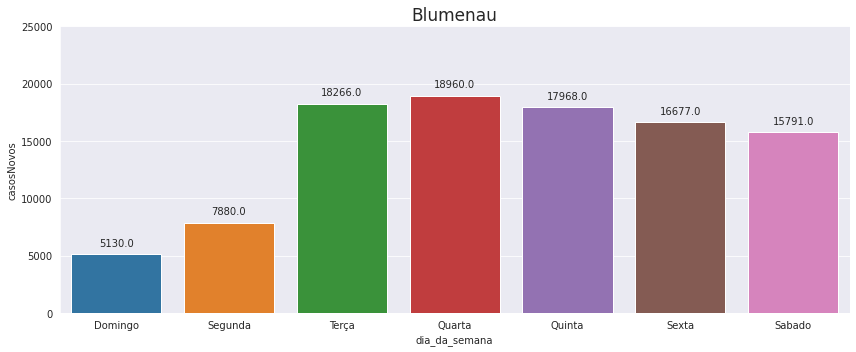

In [ ]:
plt.figure(figsize = ((12, 5)))
vplot5 = sns.barplot(blum_casos['dia_da_semana'],blum_casos.casosNovos)
plt.ylim(0, 25000)
plt.title("Blumenau", fontsize = 17)
plt.subplots_adjust(left=0.125, bottom=0.1, right=0.9, top=0.9, wspace=0.2, hspace=0.35)
for p in vplot5.patches: 
    vplot5.annotate(format(p.get_height().round()), 
                   (p.get_x() + p.get_width() / 2., p.get_height()), 
                   ha='center', va='center', 
                   xytext=(0, 11), 
                   textcoords='offset points')
plt.tight_layout()    
plt.show()

# <font color='red' style='font-size: 40px;'> Comportamento do Covid-19 nos ultimos 12 meses   </font>
<hr style='border: 2px solid red;'>
  

In [ ]:
estado_2021_8_2022_8 = dados_sc.query('data >= "2021-08-01"')
municipio_2021_8_2022_8 = dados_municipios.query('data >= "2021-08-01"')

## <font color='red' style='font-size: 40px;'> Comportamento do Covid-19 nos ultimos 12 meses no Estado de Santa Catarina  </font>
<hr style='border: 2px solid red;'>
  
 Após as vacinação avançarem no Brasil o numero de casos continua crescendo mesmo que em pouca proporção.

 Já os obitos estão caindo de agosto a dezembro de 2021, porem nos meses de janeiro a março cresce muito o numero de vitimas do virus, isso por que neste periodo é onde temos as ferias de verão, réveillon e carnaval.

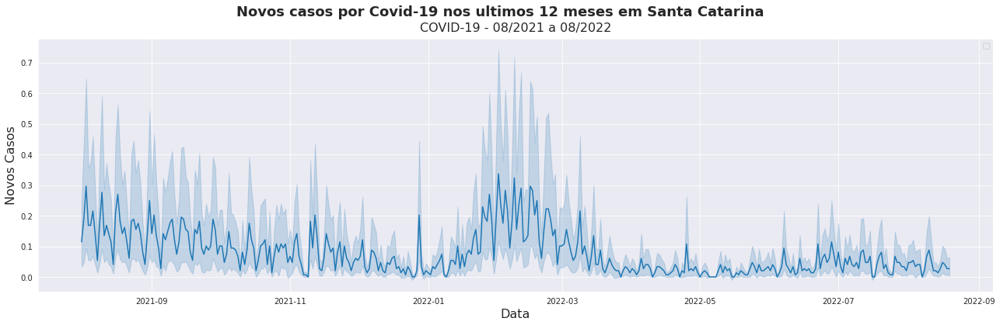

In [ ]:
plt.figure(figsize=(22,6))
sns.lineplot(estado_2021_8_2022_8['data'], estado_2021_8_2022_8['obitosNovos'])
plt.suptitle("Novos casos por Covid-19 nos ultimos 12 meses em Santa Catarina", size = 18, weight='bold')
plt.title("COVID-19 - 08/2021 a 08/2022", fontsize = 16, pad = 9)
plt.xlabel('Data', fontsize=16)
plt.ylabel('Novos Casos', fontsize=16, rotation=90)
plt.legend()
plt.show()

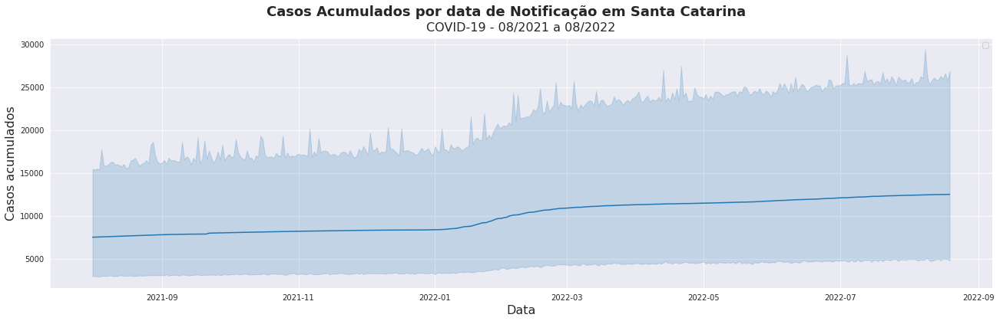

In [ ]:
plt.figure(figsize=(22,6))
sns.lineplot(estado_2021_8_2022_8['data'], estado_2021_8_2022_8['casosAcumulado'])
plt.suptitle("Casos Acumulados por data de Notificação em Santa Catarina", size = 18, weight='bold')
plt.title("COVID-19 - 08/2021 a 08/2022", fontsize = 16, pad = 9)
plt.xlabel('Data', fontsize=16)
plt.ylabel('Casos acumulados', fontsize=16, rotation=90)
plt.legend()
plt.show()

## <font color='red' style='font-size: 40px;'> Comportamento do Covid-19 nos ultimos 12 meses nos Municipios Selecionados  </font>
<hr style='border: 2px solid red;'>
  
 Após as vacinação avançarem no Brasil o numero de casos continua crescendo nos municipios de Santa Catarina mesmo que em pouca proporção comparado a 2020 e 2021.

 Já os obitos estão caindo de agosto a dezembro de 2021 nos municipios, porem nos meses de janeiro a março cresce muito o numero de vitimas do virus, isso por que neste periodo é onde temos as ferias de verão, réveillon e carnaval, os obitos aumentam em pouca proporção nos meses de final junho a agosto, acredita-se que este movimento do aumento dos obitos seja pelas ferias escolares.

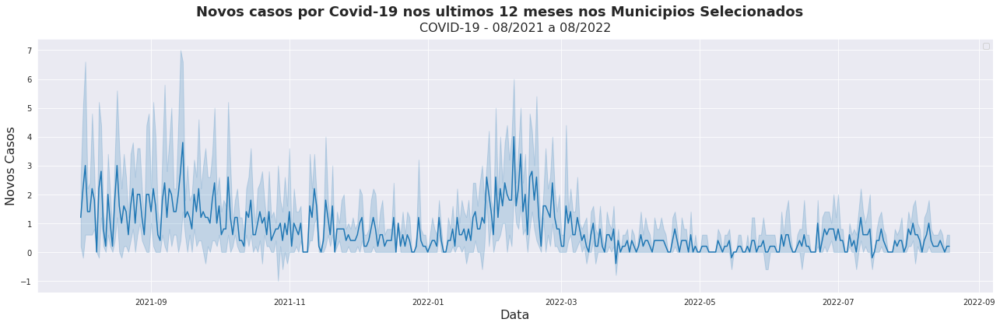

In [ ]:
plt.figure(figsize=(22,6))
sns.lineplot(municipio_2021_8_2022_8['data'], municipio_2021_8_2022_8['obitosNovos'])
plt.suptitle("Novos casos por Covid-19 nos ultimos 12 meses nos Municipios Selecionados", size = 18, weight='bold')
plt.title("COVID-19 - 08/2021 a 08/2022", fontsize = 16, pad = 9)
plt.xlabel('Data', fontsize=16)
plt.ylabel('Novos Casos', fontsize=16, rotation=90)
plt.legend()
plt.show()

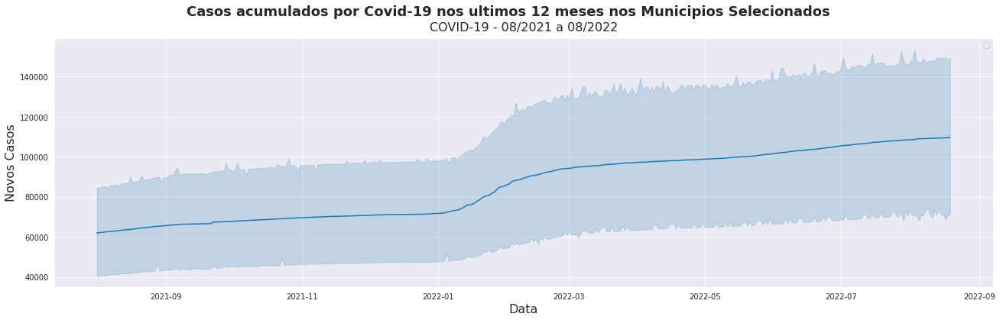

In [ ]:
plt.figure(figsize=(22,6))
sns.lineplot(municipio_2021_8_2022_8['data'], municipio_2021_8_2022_8['casosAcumulado'])
plt.suptitle("Casos acumulados por Covid-19 nos ultimos 12 meses nos Municipios Selecionados", size = 18, weight='bold')
plt.title("COVID-19 - 08/2021 a 08/2022", fontsize = 16, pad = 9)
plt.xlabel('Data', fontsize=16)
plt.ylabel('Novos Casos', fontsize=16, rotation=90)
plt.legend()
plt.show()

In [ ]:
def plot_comparacao(x, y1, y2, y3, dataset, titulo):
  plt.figure(figsize=(22,12))
  ax = plt.subplot(3,1,1)
  ax.set_title(titulo, fontsize=18,loc='left')
  sns.lineplot(x=x, y=y1, data=dataset)
  plt.subplot(3,1,2)
  sns.lineplot(x=x, y=y2, data=dataset)
  plt.subplot(3,1,3)
  sns.lineplot(x=x, y=y3, data=dataset)
  ax = ax

In [ ]:
estado_2021_8_2022_8.columns

Index(['regiao', 'estado', 'municipio', 'coduf', 'codmun', 'codRegiaoSaude',
       'nomeRegiaoSaude', 'data', 'semanaEpi', 'populacaoTCU2019',
       'casosAcumulado', 'casosNovos', 'obitosAcumulado', 'obitosNovos',
       'Recuperadosnovos', 'emAcompanhamentoNovos', 'interior/metropolitana'],
      dtype='object')

In [ ]:
estado_2021_8_2022_8['aumento'] = estado_2021_8_2022_8['casosNovos'].diff()
estado_2021_8_2022_8['aceleracao'] = estado_2021_8_2022_8['aumento'].diff()

estado_2021_8_2022_8['aumento_obito'] = estado_2021_8_2022_8['obitosNovos'].diff()
estado_2021_8_2022_8['aceleracao_obito'] = estado_2021_8_2022_8['aumento'].diff()

estado_2021_8_2022_8['aumento_obito_acumulado'] = estado_2021_8_2022_8['obitosAcumulado'].diff()
estado_2021_8_2022_8['aceleracao_obito_acumulado'] = estado_2021_8_2022_8['aumento'].diff()

estado_2021_8_2022_8['aumento_casos_acumulados'] = estado_2021_8_2022_8['casosAcumulado'].diff()
estado_2021_8_2022_8['aceleracao_casos_acumulados'] = estado_2021_8_2022_8['aumento'].diff()

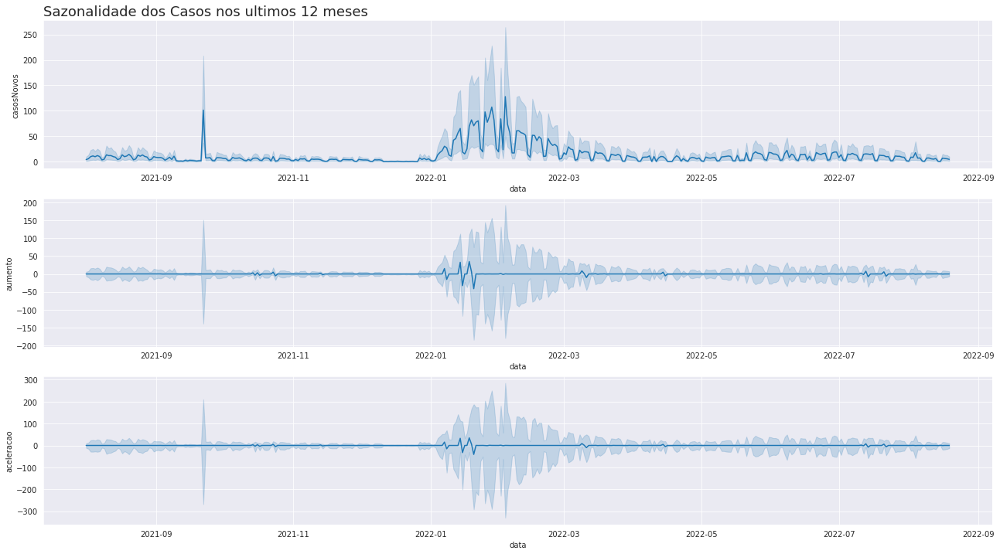

In [ ]:
plot_comparacao('data', 'casosNovos', 'aumento', 'aceleracao',
               estado_2021_8_2022_8, 'Sazonalidade dos Casos nos ultimos 12 meses')

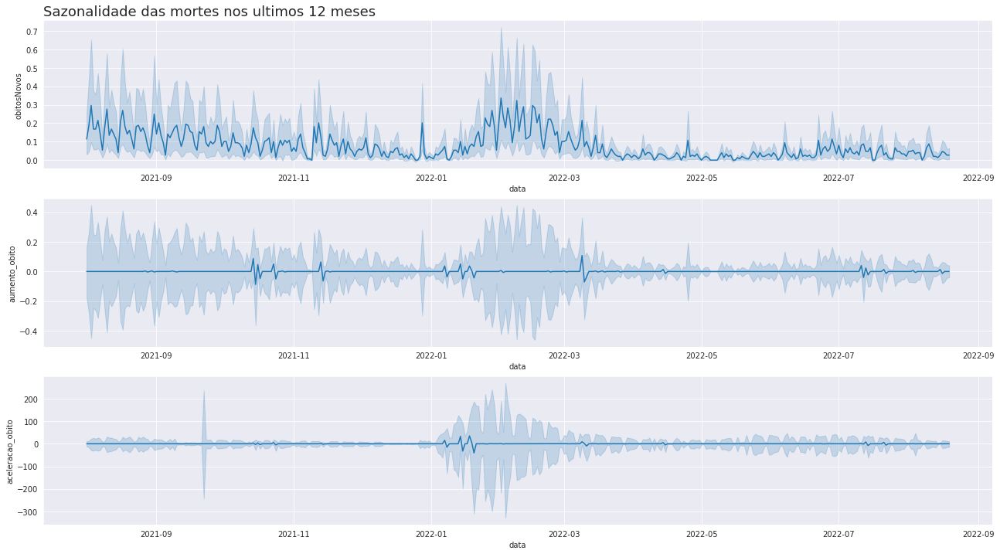

In [ ]:
plot_comparacao('data', 'obitosNovos', 'aumento_obito', 'aceleracao_obito',
               estado_2021_8_2022_8, 'Sazonalidade das mortes nos ultimos 12 meses')

In [ ]:
dados_municipios

,regiao,estado,municipio,coduf,codmun,codRegiaoSaude,nomeRegiaoSaude,data,semanaEpi,populacaoTCU2019,casosAcumulado,casosNovos,obitosAcumulado,obitosNovos,Recuperadosnovos,emAcompanhamentoNovos,interior/metropolitana
48,Sul,SC,Joinville,42,420910.0,42011.0,NORDESTE,2020-03-27,13,590466.0,0,0,0,0,NaN,NaN,0.0
61,Sul,SC,Blumenau,42,420240.0,42006.0,MEDIO VALE DO ITAJAI,2020-03-27,13,357199.0,0,0,0,0,NaN,NaN,0.0
77,Sul,SC,Florianópolis,42,420540.0,42007.0,GRANDE FLORIANOPOLIS,2020-03-27,13,500973.0,0,0,0,0,NaN,NaN,1.0
108,Sul,SC,Chapecó,42,420420.0,42002.0,OESTE,2020-03-27,13,220367.0,0,0,0,0,NaN,NaN,0.0
125,Sul,SC,Itajaí,42,420820.0,42005.0,FOZ DO RIO ITAJAI,2020-03-27,13,219536.0,0,0,0,0,NaN,NaN,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259999,Sul,SC,Florianópolis,42,420540.0,42007.0,GRANDE FLORIANOPOLIS,2022-08-19,33,500973.0,139714,110,1307,0,NaN,NaN,1.0
260039,Sul,SC,Itajaí,42,420820.0,42005.0,FOZ DO RIO ITAJAI,2022-08-19,33,219536.0,57061,2,881,0,NaN,NaN,0.0
260044,Sul,SC,Joinville,42,420910.0,42011.0,NORDESTE,2022-08-19,33,590466.0,179351,57,2304,1,NaN,NaN,0.0
260118,Sul,SC,Blumenau,42,420240.0,42006.0,MEDIO VALE DO ITAJAI,2022-08-19,33,357199.0,101812,44,807,0,NaN,NaN,0.0


In [ ]:
# casos
df4 = pd.DataFrame(dados_sc.groupby(['municipio','data']).sum()['casosAcumulado']).unstack().T.droplevel(level=0)
# obitos
df3 = pd.DataFrame(dados_sc.groupby(['municipio','data']).sum()['obitosAcumulado']).unstack().T.droplevel(level=0)

In [ ]:
dados_filtrados = dados_municipios.query('data >= "2021-08-01"')

df1 = pd.DataFrame(dados_filtrados.groupby(['municipio','data']).sum()['obitosAcumulado']).unstack().T.droplevel(level=0)


In [ ]:
df1

municipio,Blumenau,Chapecó,Florianópolis,Itajaí,Joinville
data,,,,,
2021-08-01,608,680,1015,718,1666
2021-08-02,611,680,1016,717,1674
2021-08-03,621,681,1016,719,1676
2021-08-04,623,682,1017,719,1679
2021-08-05,623,683,1018,721,1682
...,...,...,...,...,...
2022-08-15,807,863,1307,881,2301
2022-08-16,807,863,1307,881,2302
2022-08-17,807,863,1307,881,2302


In [ ]:
import bar_chart_race as bcr

In [ ]:
bcr.bar_chart_race(
    df=df3,
    filename=None,
    orientation='h',
    sort='desc',
    n_bars=10,
    fixed_order=False,
    fixed_max=True,
    steps_per_period=50,
    interpolate_period=False,
    label_bars=True,
    bar_size=.95,
    period_label={'x': .99, 'y': .25, 'ha': 'right', 'va': 'center'},
    period_fmt='%B, %Y',
    period_summary_func=lambda v, r: {'x': .99, 'y': .18,
                                      's': f'Total obitos: {v.nlargest(295).sum():,.0f}',
                                      'ha': 'right', 'size': 8, 'family': 'Courier New'},
    figsize=(6, 4),
    dpi=144,
    title='Obitos de COVID-19 em Santa Catarina',
    bar_label_size=5,
    tick_label_size=5,
    scale='linear',
    writer=None,
    fig=None,
    bar_kwargs={'alpha': .7},
    filter_column_colors=False)  

In [ ]:
bcr.bar_chart_race(
    df=df4,
    filename='casoscovid.mp4',
    orientation='h',
    sort='desc',
    n_bars=10,
    fixed_order=False,
    fixed_max=True,
    steps_per_period=50,
    interpolate_period=False,
    label_bars=True,
    bar_size=.95,
    period_label={'x': .99, 'y': .25, 'ha': 'right', 'va': 'center'},
    period_fmt='%B, %Y',
    period_summary_func=lambda v, r: {'x': .99, 'y': .18,
                                      's': f'Total Casos confirmados: {v.nlargest(295).sum():,.0f}',
                                      'ha': 'right', 'size': 8, 'family': 'Courier New'},
    figsize=(6, 4),
    dpi=144,
    title='Casos Confirmados de COVID-19 em Santa Catarina',
    bar_label_size=5,
    tick_label_size=5,
    scale='linear',
    writer=None,
    fig=None,
    bar_kwargs={'alpha': .7},
    filter_column_colors=False)  

In [ ]:
!pip install bar_chart_race
!pip install ffmpeg-python

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 156 kB 9.3 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
